In [1]:
#%matplotlib widget

In [2]:
#!export CUDA_LAUNCH_BLOCKING=1

In [3]:
%load_ext autoreload
%autoreload 2

In [4]:
#%pip install lab_black
#%load_ext lab_black
%cd ..

/home/ubuntu/SDF-Diffusion-Edit


In [5]:
from pathlib import Path

import torch as th
import torch.nn.functional as F
import numpy as np
import yaml
from easydict import EasyDict

from src.utils import instantiate_from_config, get_device
from src.utils.vis import save_sdf_as_mesh, plot_sdfs

from tqdm import tqdm

In [6]:
th.set_grad_enabled(False)
device = get_device()
#device='cpu'
device

device(type='cuda')

In [7]:
gen32_args_path = "config/gen32/chair.yaml"
gen32_ckpt_path = "results/gen32/chair.pth"
sr64_args_path = "config/sr32_64/chair.yaml"
sr64_ckpt_path = "results/sr32_64/chair.pth"

In [8]:
with open(gen32_args_path) as f:
    args1 = EasyDict(yaml.safe_load(f))
with open(sr64_args_path) as f:
    args2 = EasyDict(yaml.safe_load(f))

In [9]:
model1 = instantiate_from_config(args1.model)
ckpt = th.load(gen32_ckpt_path, map_location=device)
model1.load_state_dict(ckpt["model_ema"])
model1 = model1.to(device)
model1.eval()
model1.training

False

In [10]:
model2 = instantiate_from_config(args2.model)
ckpt = th.load(sr64_ckpt_path, map_location=device)
model2.load_state_dict(ckpt["model"])
model2 = model2.to(device)
model2.eval()
model2.training

False

In [11]:
from src.models.gaussian_diffusion import create_gaussian_diffusion
noise_level_func = "sqrt_alphas_cumprod_next"
ddpm_sampler1 = create_gaussian_diffusion(noise_level_func=noise_level_func, **args1.ddpm_new.valid.params)
ddpm_sampler2 = create_gaussian_diffusion(noise_level_func=noise_level_func, **args2.ddpm_new.valid.params)

#ddpm_sampler1, ddpm_sampler2 = ddpm_sampler1.to(device), ddpm_sampler2.to(device)

In [12]:
preprocessor1 = instantiate_from_config(args1.preprocessor, device=device)
preprocessor2 = instantiate_from_config(args2.preprocessor, device=device)

/home/ubuntu/miniconda3/envs/pytorch3d/lib/python3.9/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


# Generate Low-Resolution ($32^3$)

Generates 5 low-resolution samples

In [16]:
def plot_debug_func(x, iter, every_t=15, **plot_sdfs_kwargs):
    if iter % every_t == 0 or iter == len(ddpm_sampler1.use_timesteps)-1:
        title = f"iter: {iter} / {len(ddpm_sampler1.use_timesteps)}"
        plot_sdfs(x, title=title, **plot_sdfs_kwargs)

  0%|          | 0/50 [00:00<?, ?it/s]

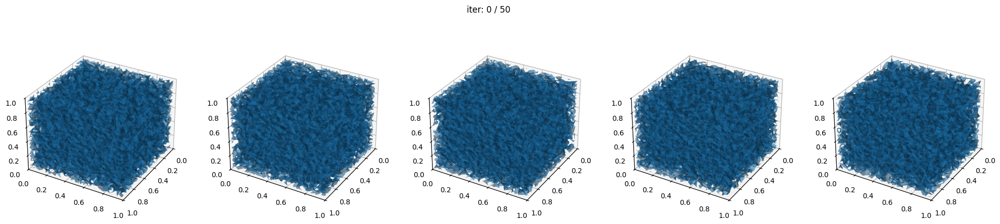

 30%|███       | 15/50 [00:37<00:18,  1.90it/s]

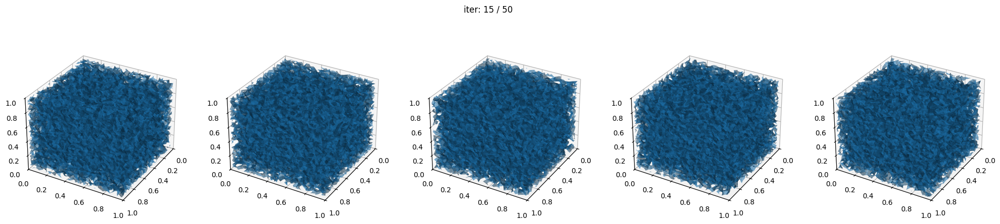

 60%|██████    | 30/50 [01:14<00:10,  1.89it/s]

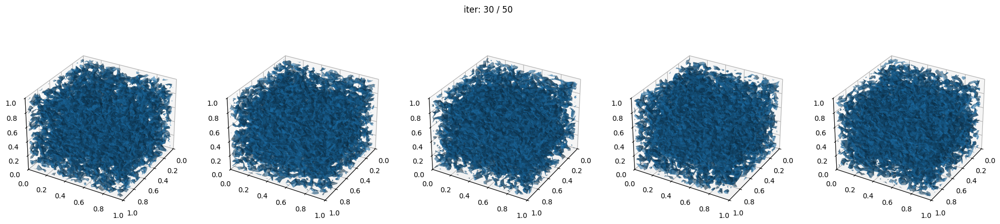

 90%|█████████ | 45/50 [01:46<00:02,  1.94it/s]

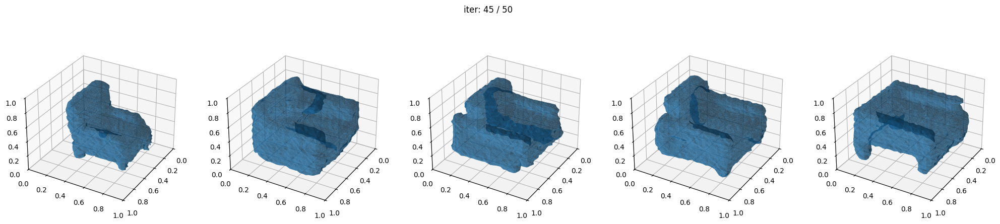

 98%|█████████▊| 49/50 [01:52<00:00,  1.19it/s]

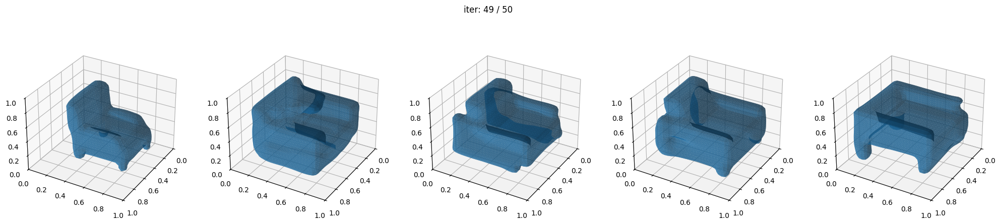

100%|██████████| 50/50 [01:55<00:00,  2.30s/it]


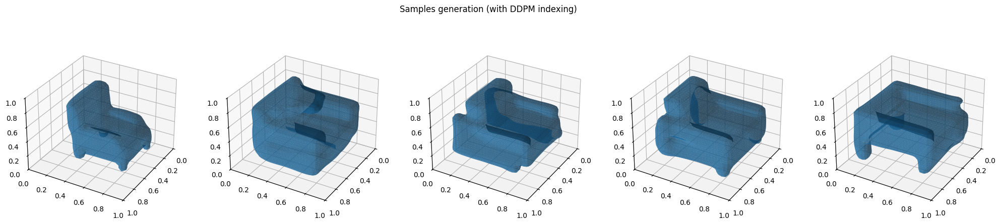

  0%|          | 0/50 [00:00<?, ?it/s]

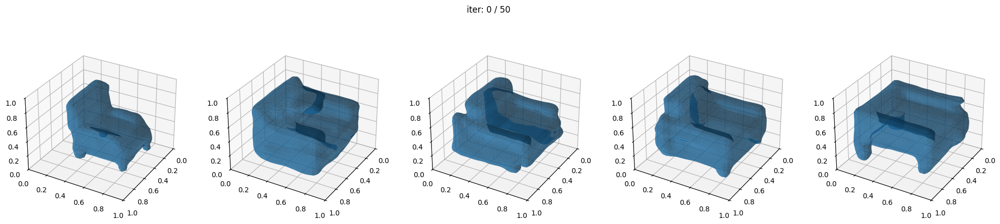

 30%|███       | 15/50 [00:09<00:16,  2.12it/s]

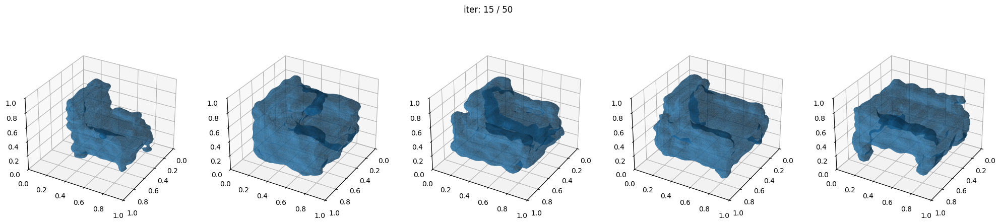

 60%|██████    | 30/50 [00:19<00:09,  2.11it/s]

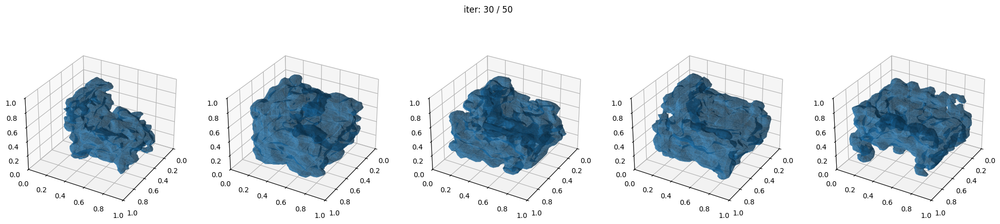

 90%|█████████ | 45/50 [00:30<00:02,  2.09it/s]

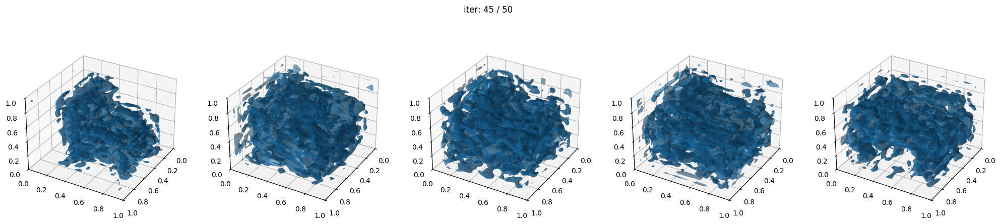

 98%|█████████▊| 49/50 [00:40<00:01,  1.32s/it]

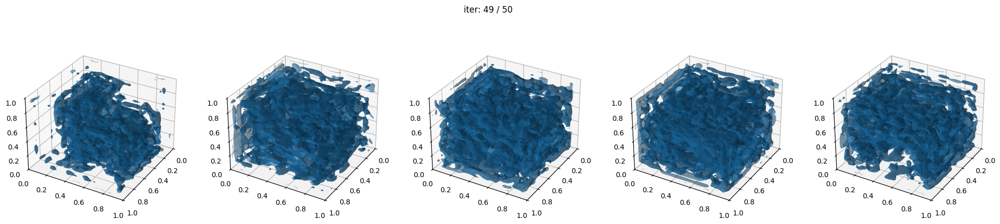

  0%|          | 0/50 [00:00<?, ?it/s]

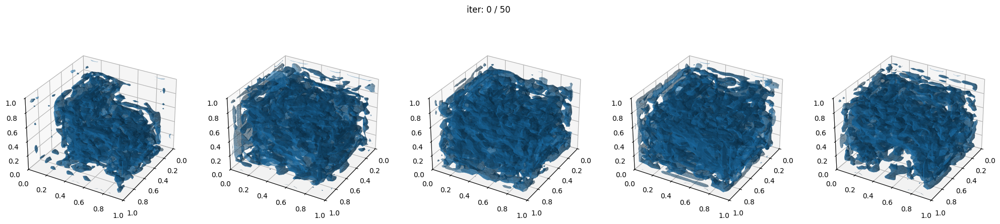

 30%|███       | 15/50 [00:19<00:17,  2.03it/s]

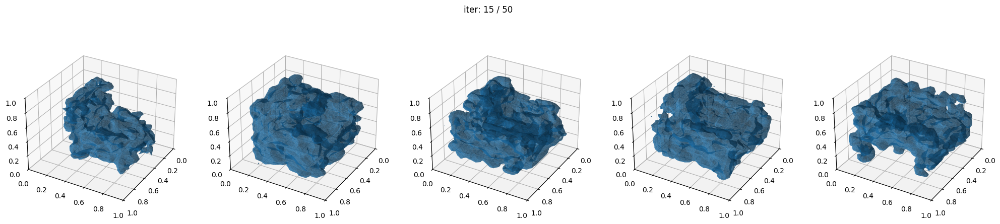

 60%|██████    | 30/50 [00:31<00:09,  2.09it/s]

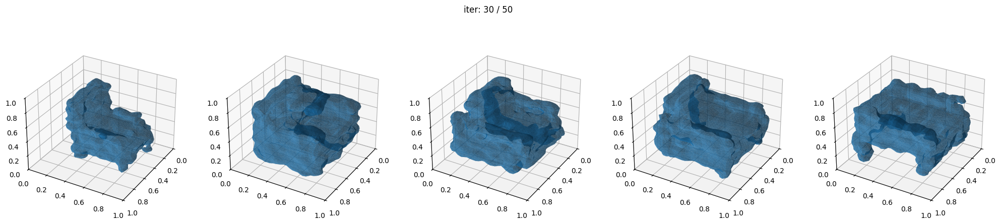

 90%|█████████ | 45/50 [00:42<00:02,  2.10it/s]

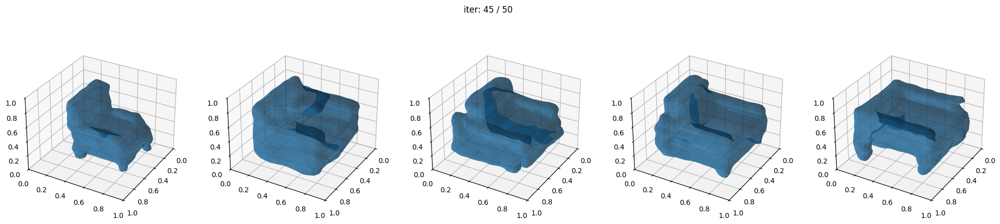

 98%|█████████▊| 49/50 [00:47<00:00,  1.30it/s]

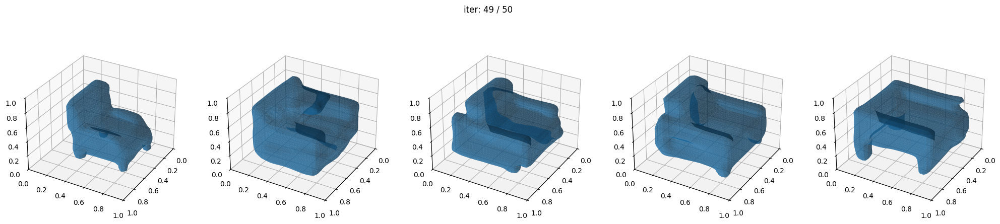

100%|██████████| 50/50 [00:50<00:00,  1.01s/it]


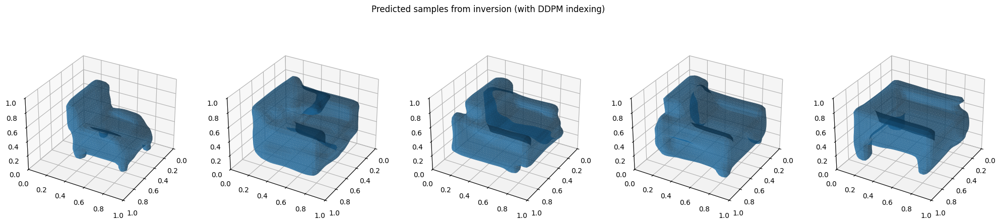

In [17]:
from src.utils.utils import seed_everything
seed_everything(40)
five_samples_ddpm_indexing = ddpm_sampler1.ddim_sample_loop(model1, shape=(5, 1, 32, 32, 32), progress=True, plot_debug_func=plot_debug_func, device=device)
plot_sdfs(list(five_samples_ddpm_indexing), title="Samples generation (with DDPM indexing)")
plot_sdfs(list(
    ddpm_sampler1.ddim_sample_loop(
        model1,
        x_t=ddpm_sampler1.ddim_sample_loop(model1, x_t=five_samples_ddpm_indexing, inverse=True, progress=True, plot_debug_func=plot_debug_func, device=device),
        progress=True,
        plot_debug_func=plot_debug_func,
        device=device
    )),
    title="Predicted samples from inversion (with DDPM indexing)")

Compare with training mode

Model 1 is on training mode:  True
Model 2 is on training mode:  True


  0%|          | 0/50 [00:00<?, ?it/s]

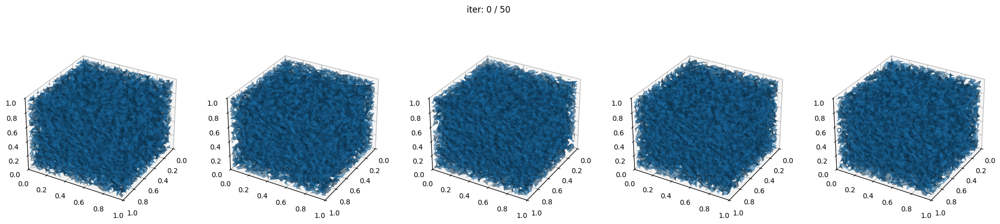

 30%|███       | 15/50 [01:45<00:23,  1.46it/s] 

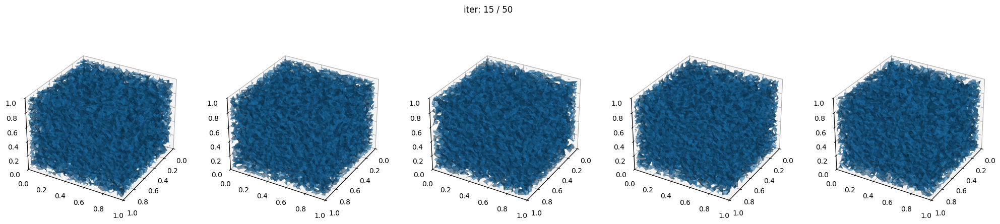

 60%|██████    | 30/50 [03:03<00:12,  1.63it/s]

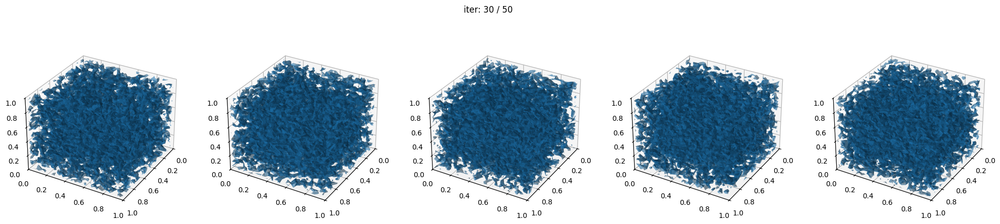

 90%|█████████ | 45/50 [04:03<00:02,  1.73it/s]

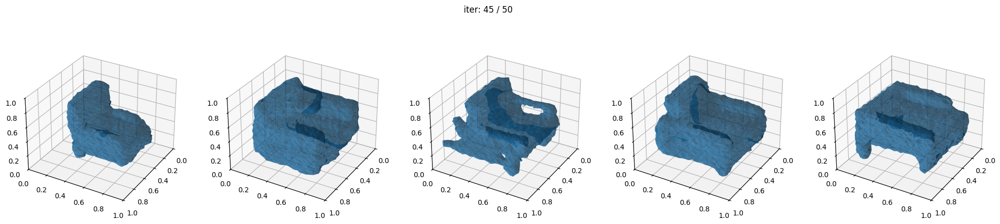

 98%|█████████▊| 49/50 [04:12<00:01,  1.17s/it]

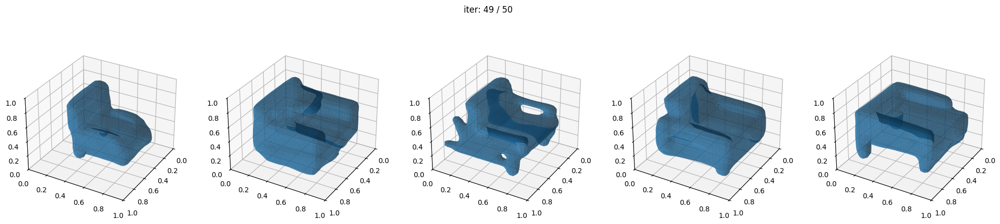

100%|██████████| 50/50 [04:19<00:00,  5.18s/it]


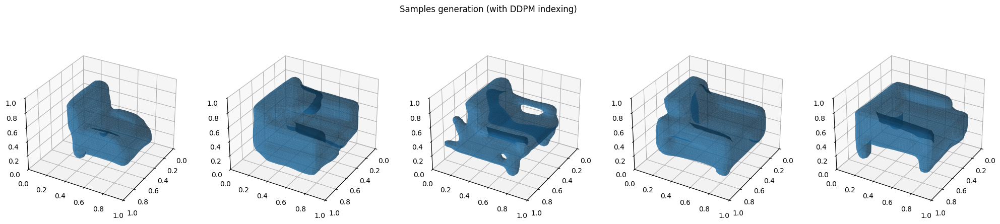

  0%|          | 0/50 [00:00<?, ?it/s]

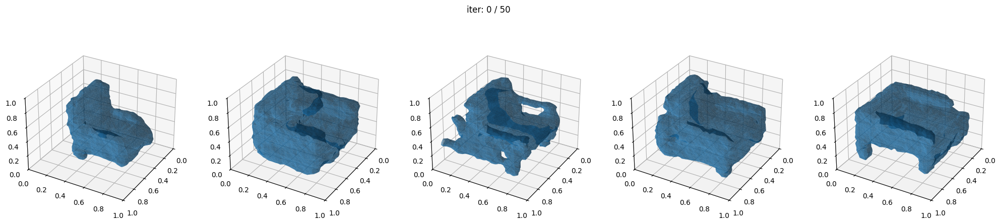

 30%|███       | 15/50 [07:52<00:49,  1.42s/it]  

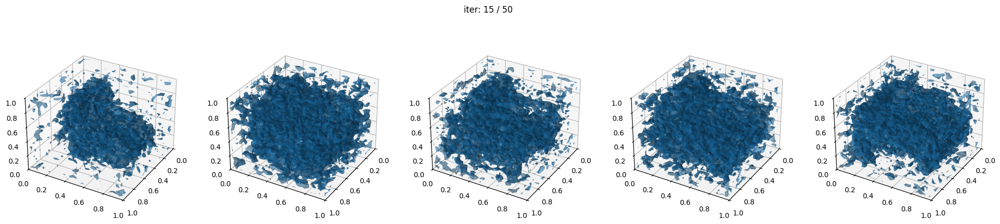

 60%|██████    | 30/50 [08:26<00:10,  1.91it/s]

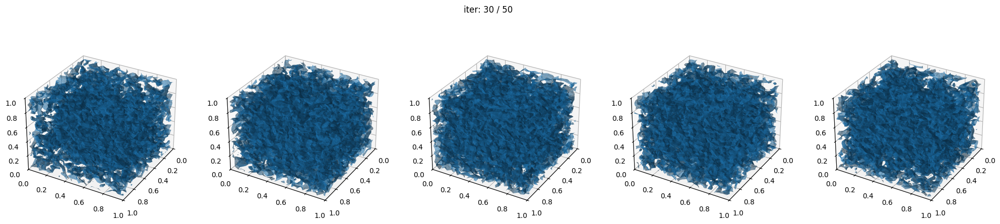

 90%|█████████ | 45/50 [09:23<00:02,  1.76it/s]

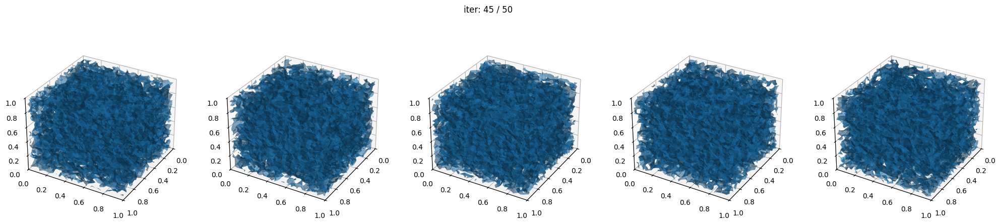

 98%|█████████▊| 49/50 [10:17<00:05,  5.80s/it]

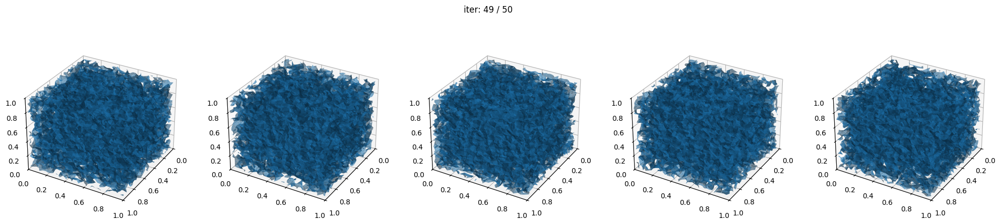

  0%|          | 0/50 [00:00<?, ?it/s]

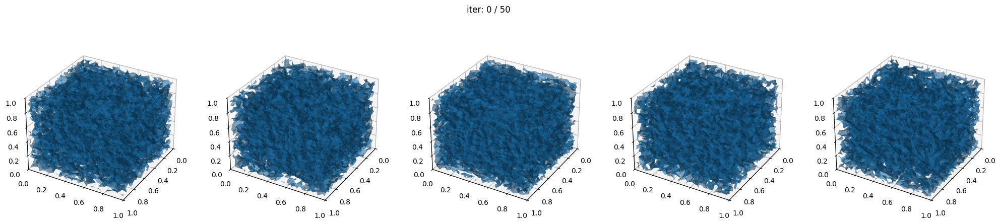

 30%|███       | 15/50 [00:58<00:20,  1.75it/s]

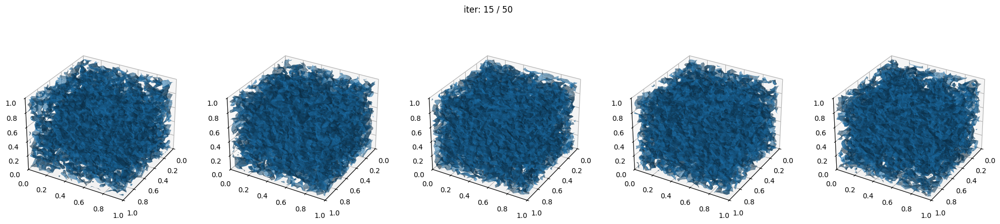

 60%|██████    | 30/50 [01:53<00:11,  1.77it/s]

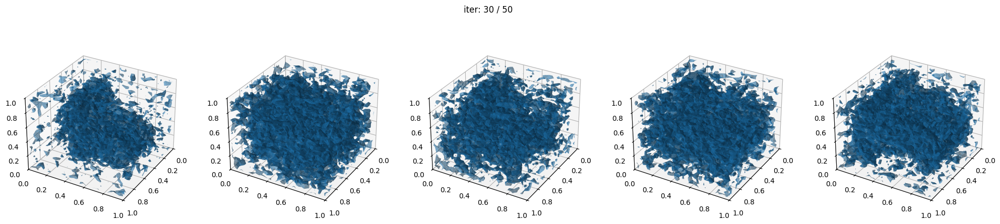

 90%|█████████ | 45/50 [02:32<00:02,  1.88it/s]

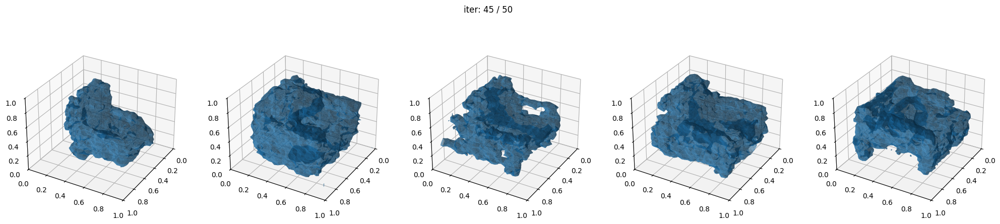

 98%|█████████▊| 49/50 [02:43<00:01,  1.47s/it]

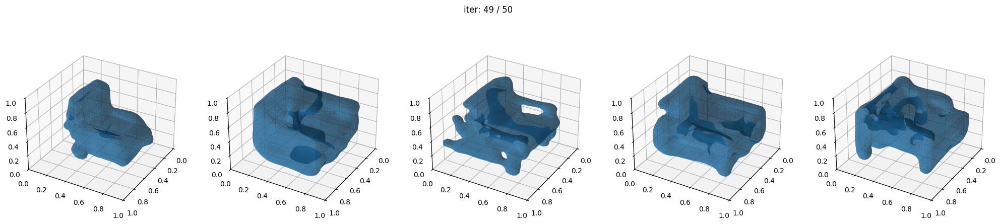

100%|██████████| 50/50 [02:51<00:00,  3.43s/it]


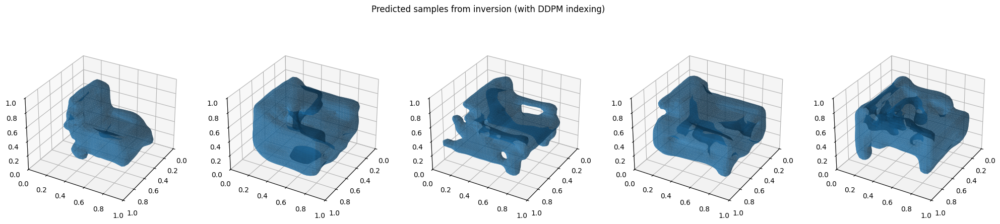

In [19]:
model1 = instantiate_from_config(args1.model)
ckpt = th.load(gen32_ckpt_path, map_location=device)
model1.load_state_dict(ckpt["model_ema"])
model1 = model1.to(device)
model1.train()
print("Model 1 is on training mode: ", model1.training)
model2 = instantiate_from_config(args2.model)
ckpt = th.load(sr64_ckpt_path, map_location=device)
model2.load_state_dict(ckpt["model"])
model2 = model2.to(device)
model2.train()
print("Model 2 is on training mode: ", model2.training)


from src.utils.utils import seed_everything
seed_everything(40)
five_samples_ddpm_indexing = ddpm_sampler1.ddim_sample_loop(model1, shape=(5, 1, 32, 32, 32), progress=True, plot_debug_func=plot_debug_func, device=device)
plot_sdfs(list(five_samples_ddpm_indexing), title="Samples generation (with DDPM indexing)")
plot_sdfs(list(
    ddpm_sampler1.ddim_sample_loop(
        model1,
        x_t=ddpm_sampler1.ddim_sample_loop(model1, x_t=five_samples_ddpm_indexing, inverse=True, progress=True, plot_debug_func=plot_debug_func, device=device),
        progress=True,
        plot_debug_func=plot_debug_func,
        device=device
    )),
    title="Predicted samples from inversion (with DDPM indexing)")